# Setting up GPU

In [1]:
%env CUDA_DEVICE_ORDER=PCI_BUS_ID
%env CUDA_VISIBLE_DEVICES=2

env: CUDA_DEVICE_ORDER=PCI_BUS_ID
env: CUDA_VISIBLE_DEVICES=2


In [3]:
import torch
print(torch.cuda.is_available())


False


In [2]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

In [3]:
import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'  
os.environ['XLA_FLAGS'] = '--xla_gpu_cuda_data_dir=/dev/null'
os.environ['PYTORCH_CUDA_ALLOC_CONF'] = 'expandable_segments:True'

# Imports and Definitions

In [4]:
# Import of libraries
import random
import imageio
import numpy as np
from argparse import ArgumentParser
from tqdm.auto import tqdm
import matplotlib.pyplot as plt
import einops
import torch
import torch.nn as nn
from torch.optim import Adam
from torch.utils.data import DataLoader
from torchvision.transforms import Compose, ToTensor, Lambda
from torchvision import models, transforms
from scipy.linalg import sqrtm
# Setting reproducibility
SEED = 42
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)

## Getting device



In [5]:
# Getting device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
# device = torch.device("cpu")
print(f"Using device: {device}\t" + (f"{torch.cuda.get_device_name(0)}" if torch.cuda.is_available() else "CPU"))

Using device: cuda	Tesla V100-SXM2-16GB


## Execution options

Here's a few options you should set:

 - `no_train` specifies whether you want to skip the training loop and just use a pre-trained model. If you haven't trained a model already using this notebook, keep this as `False`. If you want to use a pre-trained model, load it in the colab filesystem.

- `batch_size`, `n_epochs` and `lr` are your typical training hyper-parameters. Notice that `lr=0.001` is the hyper-parameter used by the authors.


In [6]:
no_train = True
batch_size = 64
n_epochs = 50
lr = 0.001

# Utility functions

Following are two utility functions: `show_images` allows to display images in a square-like pattern with a custom title, while `show_fist_batch` simply shows the images in the first batch of a DataLoader object.

In [7]:
def show_images(images, title=""):
    """Shows the provided images as sub-pictures in a square"""

    # Converting images to CPU numpy arrays
    if type(images) is torch.Tensor:
        images = images.detach().cpu().numpy()

    # Defining number of rows and columns
    fig = plt.figure(figsize=(20, 20))
    rows = int(len(images) ** (1 / 2))
    cols = round(len(images) / rows)

    # Populating figure with sub-plots
    idx = 0
    for r in range(rows):
        for c in range(cols):
            fig.add_subplot(rows, cols, idx + 1)

            if idx < len(images):
                # print(images[idx][0])####
                # print(len(images[idx][0]))
                # print("#########")
                plt.imshow(images[idx][0], cmap="gray")
                idx += 1
    fig.suptitle(title, fontsize=30)

    # Showing the figure
    plt.show()

In [8]:
def show_first_batch(loader):
    for batch in loader:
        show_images(batch[0], "Images in the first batch")
        break

## Loading data


In [9]:
data_path = '/tf/chest_xray/train'

from torchvision import transforms
from torchvision.datasets import ImageFolder
from torchvision.transforms import Compose, ToTensor, Lambda
from torch.utils.data import DataLoader

transform = transforms.Compose([
    transforms.Resize((64, 64)),   # Resize images to 64x64
    transforms.Grayscale(),        # Convert images to grayscale
    transforms.ToTensor(),         # Convert images to tensor and scale to [0, 1]
    # No additional normalization needed since ReadDataset scales images to [0, 1]
])
dataset = ImageFolder(data_path, transform=transform)

loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

In [10]:
# Extract all images and labels from the dataset
all_images = []
all_labels = []

for img, label in dataset:
    all_images.append(img)
    all_labels.append(label)

# Convert lists to tensors if needed
images = torch.stack(all_images)
labels = torch.tensor(all_labels)

print(images.shape)  # Shape: [num_samples, 1, 64, 64]
print(labels.shape)  # Shape: [num_samples]

torch.Size([5216, 1, 64, 64])
torch.Size([5216])


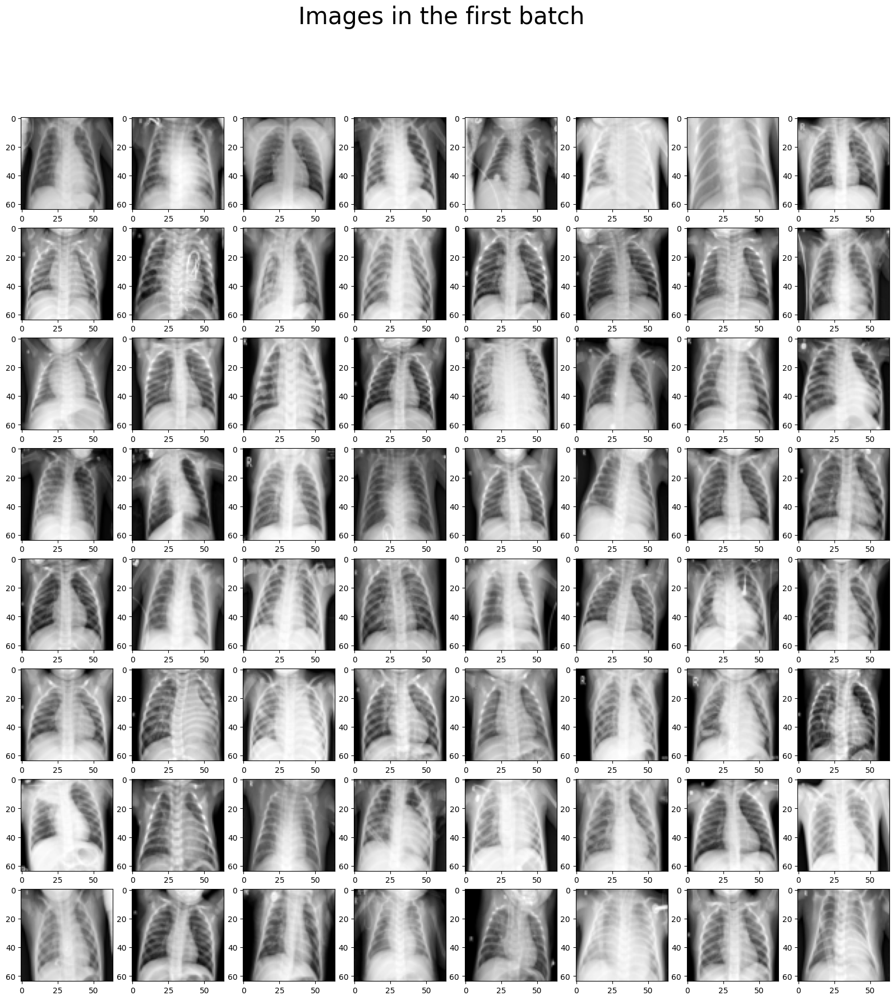

In [11]:
# Optionally, show a batch of regular images
show_first_batch(loader)

# Defining the DDPM module

We now proceed and define a DDPM PyTorch module. Since in principle the DDPM scheme is independent of the model architecture used in each denoising step, we define a high-level model that is constructed using a `network` parameter, as well as:

- `n_steps`: number of diffusion steps $T$;
- `min_beta`: value of the first $\beta_t$ ($\beta_1$);
- `max_beta`: value of the last  $\beta_t$ ($\beta_T$);
- `device`: device onto which the model is run;
- `image_chw`: tuple contining dimensionality of images.

The `forward` process of DDPMs benefits from a nice property: We don't actually need to slowly add noise step-by-step, but we can directly skip to whathever step $t$ we want using coefficients $\alpha_bar$.

For the `backward` method instead, we simply let the network do the job.

Note that in this implementation, $t$ is assumed to be a `(N, 1)` tensor, where `N` is the number of images in tensor `x`. We thus support different time-steps for multiple images.

In [12]:
class MyDDPM(nn.Module):
    def __init__(self, network, n_steps=200, min_beta=10 ** -4, max_beta=0.02, device=None, image_chw=(1, 64, 64)):
        super(MyDDPM, self).__init__()
        self.n_steps = n_steps
        self.device = device
        self.image_chw = image_chw
        self.network = network.to(device)
        self.betas = torch.linspace(min_beta, max_beta, n_steps).to(device)
        self.alphas = 1 - self.betas
        self.alpha_bars = torch.tensor([torch.prod(self.alphas[:i + 1]) for i in range(len(self.alphas))]).to(device)

    def forward(self, x0, t, eta=None, class_label=None):
        # Make input image more noisy (we can directly skip to the desired step)
        n, c, h, w = x0.shape
        a_bar = self.alpha_bars[t]
        # Debugging: Check class_label before passing to the network
        if class_label is None:
            raise ValueError("class_label is None in MyDDPM forward method")
        if eta is None:
            eta = torch.randn(n, c, h, w).to(self.device)

        noisy = a_bar.sqrt().reshape(n, 1, 1, 1) * x0 + (1 - a_bar).sqrt().reshape(n, 1, 1, 1) * eta
         # Get the noise prediction and class predictions from the network
        eta_theta, class_preds = self.network(noisy, t, class_label)
        return noisy, class_preds

    def backward(self, x, t, class_label):
        # Run each image through the network for each timestep t in the vector t.
        # The network returns its estimation of the noise that was added.
        return self.network(x, t, class_label)


## Visualizing forward and backward

Now that we have defined the high-level functioning of a DDPM model, we can already define some related utility functions.

In particular, we will be showing the forward process (which is independent of the denoising network) with the `show_forward` method.

We run the backward pass and generate new images with the `generate_new_images` method, but this time we will put more effort into the function and also make it such that a GIF image is created. Notice that in the paper (https://arxiv.org/pdf/2006.11239.pdf) by Ho et. al., two options are considered for $\sigma_t^2$:

- $\sigma_t^2$ = $\beta_t$
- $\sigma_t^2$ = $\frac{1 - \bar{\alpha_{t-1}}}{1 - \bar{\alpha_{t}}} \beta_t$

In this implementation, they are both a few line-comments away. However, the two terms are rougly always the same and little difference is noticeable. By default, I choose the first option out of simplicity.

In [13]:
print(torch.ones(10))

tensor([1., 1., 1., 1., 1., 1., 1., 1., 1., 1.])


In [14]:
def show_forward(ddpm, loader, device):
    # Showing the forward process
    for batch in loader:
        imgs = batch[0]

        show_images(imgs, "Original images")

        for percent in [0.25, 0.5, 0.75, 1]:
            show_images(
                ddpm(imgs.to(device),
                     [int(percent * ddpm.n_steps) - 1 for _ in range(len(imgs))]),
                f"DDPM Noisy images {int(percent * 100)}%"
            )
        break

In [15]:
def generate_new_images(ddpm, class_labels, n_samples=16, device=None, frames_per_gif=100, gif_name="sampling.gif", c=1, h=64, w=64):
    """Given a DDPM model, a number of samples to be generated and a device, returns some newly generated samples"""
    frame_idxs = np.linspace(0, ddpm.n_steps, frames_per_gif).astype(np.uint)
    frames = []

    with torch.no_grad():
        if device is None:
            device = ddpm.device

        # Starting from random noise
        x = torch.randn(n_samples, c, h, w).to(device)
        class_labels = class_labels.to(device)

        for idx, t in enumerate(list(range(ddpm.n_steps))[::-1]):
            # Estimating noise to be removed
            time_tensor = (torch.ones(n_samples, 1) * t).to(device).long()
            eta_theta,_ = ddpm.backward(x, time_tensor, class_labels)

            alpha_t = ddpm.alphas[t].to(device)
            alpha_t_bar = ddpm.alpha_bars[t].to(device)

            # Partially denoising the image
            x = (1 / alpha_t.sqrt()) * (x - (1 - alpha_t) / (1 - alpha_t_bar).sqrt() * eta_theta)

            if t > 0:
                z = torch.randn(n_samples, c, h, w).to(device)
                beta_t = ddpm.betas[t].to(device)
                sigma_t = beta_t.sqrt()
                x = x + sigma_t * z

            # Adding frames to the GIF
            if idx in frame_idxs or t == 0:
                normalized = x.clone()
                for i in range(len(normalized)):
                    normalized[i] -= torch.min(normalized[i])
                    normalized[i] *= 255 / torch.max(normalized[i])
                frame = einops.rearrange(normalized, "(b1 b2) c h w -> (b1 h) (b2 w) c", b1=int(n_samples ** 0.5))
                frame = frame.cpu().numpy().astype(np.uint8)
                frames.append(frame)

    with imageio.get_writer(gif_name, mode="I") as writer:
        for idx, frame in enumerate(frames):
            rgb_frame = np.repeat(frame, 3, axis=2)
            writer.append_data(rgb_frame)
            if idx == len(frames) - 1:
                last_rgb_frame = np.repeat(frames[-1], 3, axis=2)
                for _ in range(frames_per_gif // 3):
                    writer.append_data(last_rgb_frame)

    return x


# UNet architecture

 So now we simply define an architecture that will be responsible of denoising the we should be good to go... Not so fast! While in principle that's true, we have to be careful to conditioning our model with the temporal information.

Remember that the only term of the loss function that we really care about is $||\epsilon - \epsilon_\theta(\sqrt{\bar{\alpha}_t}x_0 + \sqrt{1 - \bar{\alpha}_t}\epsilon, t)||^2$, where $\epsilon$ is some random noise and $\epsilon_\theta$ is the model's prediction of the noise. Now, $\epsilon_\theta$ is a function of both $x$ and $t$ and we don't want to have a distinct model for each denoising step (thousands of independent models), but instead we want to use a single model that takes as input the image $x$ and the scalar value indicating the timestep $t$.

To do so, in practice we use a sinusoidal embedding (function `sinusoidal_embedding`) that maps each time-step to a `time_emb_dim` dimension. These time embeddings are further mapped with some time-embedding MLPs (function `_make_te`) and added to tensors through the network in a channel-wise manner.

In [16]:
def sinusoidal_embedding(n, d):
    # Returns the standard positional embedding
    embedding = torch.zeros(n, d)
    wk = torch.tensor([1 / 10_000 ** (2 * j / d) for j in range(d)])
    wk = wk.reshape((1, d))
    t = torch.arange(n).reshape((n, 1))
    embedding[:,::2] = torch.sin(t * wk[:,::2])
    embedding[:,1::2] = torch.cos(t * wk[:,::2])

    return embedding

class MyBlock(nn.Module):
    def __init__(self, shape, in_c, out_c, kernel_size=3, stride=1, padding=1, activation=None, normalize=True):
        super(MyBlock, self).__init__()
        self.ln = nn.LayerNorm(shape)
        self.conv1 = nn.Conv2d(in_c, out_c, kernel_size, stride, padding)
        self.conv2 = nn.Conv2d(out_c, out_c, kernel_size, stride, padding)
        self.activation = nn.SiLU() if activation is None else activation
        self.normalize = normalize

    def forward(self, x):
        out = self.ln(x) if self.normalize else x
        out = self.conv1(out)
        out = self.activation(out)
        out = self.conv2(out)
        out = self.activation(out)
        return out


class MyUNet(nn.Module):
    def __init__(self, n_steps=1000, time_emb_dim=100, num_classes=2):
        super(MyUNet, self).__init__()

        self.num_classes = num_classes
        
        # Sinusoidal embedding
        self.time_embed = nn.Embedding(n_steps, time_emb_dim)
        self.time_embed.weight.data = sinusoidal_embedding(n_steps, time_emb_dim)
        self.time_embed.requires_grad_(False)
        
       # Class embedding
        self.class_embed = nn.Embedding(num_classes, time_emb_dim)

        # Combine embeddings dimension
        self.embed_fc = nn.Linear(2 * time_emb_dim, time_emb_dim)
        
        # First half
        self.te1 = self._make_te(time_emb_dim, 1)
        self.b1 = nn.Sequential(
            MyBlock((1, 64, 64), 1, 10),
            MyBlock((10, 64, 64), 10, 10),
            MyBlock((10, 64, 64), 10, 10),
        )
        self.down1 = nn.Conv2d(10, 10, 4, 2, 1)  # Downsample to 32x32

        self.te2 = self._make_te(time_emb_dim, 10)
        self.b2 = nn.Sequential(
            MyBlock((10, 32, 32), 10, 20),
            MyBlock((20, 32, 32), 20, 20),
            MyBlock((20, 32, 32), 20, 20),
        )
        self.down2 = nn.Conv2d(20, 20, 4, 2, 1)  # Downsample to 16x16

        self.te3 = self._make_te(time_emb_dim, 20)
        self.b3 = nn.Sequential(
            MyBlock((20, 16, 16), 20, 40),
            MyBlock((40, 16, 16), 40, 40),
            MyBlock((40, 16, 16), 40, 40),
        )
        self.down3 = nn.Conv2d(40, 40, 4, 2, 1)  # Downsample to 8x8

        self.te4 = self._make_te(time_emb_dim, 40)
        self.b4 = nn.Sequential(
            MyBlock((40, 8, 8), 40, 80),
            MyBlock((80, 8, 8), 80, 80),
            MyBlock((80, 8, 8), 80, 80),
        )
        self.down4 = nn.Conv2d(80, 80, 4, 2, 1)  # Downsample to 4x4

        self.te5 = self._make_te(time_emb_dim, 80)
        self.b5 = nn.Sequential(
            MyBlock((80, 4, 4), 80, 160),
            MyBlock((160, 4, 4), 160, 160),
            MyBlock((160, 4, 4), 160, 160),
        )
        self.down5 = nn.Sequential(
            nn.Conv2d(160, 160, 4, 2, 1),  # Downsample to 2x2
            nn.SiLU(),
            nn.Conv2d(160, 160, 4, 2, 1)  # Downsample to 1x1
        )

        # Bottleneck
        self.te_mid = self._make_te(time_emb_dim, 160)

        self.b_mid = nn.Sequential(
            MyBlock((160, 1, 1), 160, 80),
            MyBlock((80, 1, 1), 80, 80),
            MyBlock((80, 1, 1), 80, 160),
        )

        # Second half (upsampling)
        self.up1 = nn.Sequential(
            nn.ConvTranspose2d(160, 160, 4, 2, 1),  # Upsample to 2x2
            nn.SiLU(),
            nn.ConvTranspose2d(160, 160, 4, 2, 1)   # Upsample to 4x4
        )
        self.te6 = self._make_te(time_emb_dim, 320)
        self.b6 = nn.Sequential(
            MyBlock((320, 4, 4), 320, 160),
            MyBlock((160, 4, 4), 160, 80),
            MyBlock((80, 4, 4), 80, 80),
        )

        self.up2 = nn.ConvTranspose2d(80, 80, 4, 2, 1)  # Upsample to 8x8
        self.te7 = self._make_te(time_emb_dim, 160)
        self.b7 = nn.Sequential(
            MyBlock((160, 8, 8), 160, 80),
            MyBlock((80, 8, 8), 80, 40),
            MyBlock((40, 8, 8), 40, 40),
        )

        self.up3 = nn.ConvTranspose2d(40, 40, 4, 2, 1)  # Upsample to 16x16
        self.te8 = self._make_te(time_emb_dim, 80)
        self.b8 = nn.Sequential(
            MyBlock((80, 16, 16), 80, 40),
            MyBlock((40, 16, 16), 40, 20),
            MyBlock((20, 16, 16), 20, 20),
        )

        self.up4 = nn.ConvTranspose2d(20, 20, 4, 2, 1)  # Upsample to 32x32
        self.te9 = self._make_te(time_emb_dim, 40)
        self.b9 = nn.Sequential(
            MyBlock((40, 32, 32), 40, 20),
            MyBlock((20, 32, 32), 20, 10),
            MyBlock((10, 32, 32), 10, 10),
        )

        self.up5 = nn.ConvTranspose2d(10, 10, 4, 2, 1)  # Upsample to 64x64
        self.te_out = self._make_te(time_emb_dim, 20)
        self.b_out = nn.Sequential(
            MyBlock((20, 64, 64), 20, 10),
            MyBlock((10, 64, 64), 10, 10),
            MyBlock((10, 64, 64), 10, 10, normalize=False),
        )

        self.conv_out = nn.Conv2d(10, 1, 3, 1, 1)
        self.classifier = nn.Linear(160, 1)

    def forward(self, x, t, class_labels):
        if class_labels is None:
            raise ValueError("class_labels are None but expected Tensor.")

        # x is (N, 2, 64, 64) (image with positional embedding stacked on channel dimension)
        t = self.time_embed(t).view(t.size(0), -1)  # Shape: (batch_size, embedding_dim)
        c = self.class_embed(class_labels).view(class_labels.size(0), -1)  # Shape: (batch_size, embedding_dim)
        
        # Combine the embeddings
        combined_embedding = torch.cat((t, c), dim=1)
        combined_embedding = self.embed_fc(combined_embedding)
        
        #print(f"t shape {t.shape}")
        #print(f"c shape {c.shape}")
        #print(f"tc shape {combined_embedding.shape}")
        #print(x.dtype)
        #print(combined_embedding.dtype)
        n = len(x)
        out1 = self.b1(x + self.te1(combined_embedding).reshape(n, -1, 1, 1))  # (N, 10, 64, 64)
        out2 = self.b2(self.down1(out1) + self.te2(combined_embedding).reshape(n, -1, 1, 1))  # (N, 20, 32, 32)
        out3 = self.b3(self.down2(out2) + self.te3(combined_embedding).reshape(n, -1, 1, 1))  # (N, 40, 16, 16)
        out4 = self.b4(self.down3(out3) + self.te4(combined_embedding).reshape(n, -1, 1, 1))  # (N, 80, 8, 8)
        out5 = self.b5(self.down4(out4) + self.te5(combined_embedding).reshape(n, -1, 1, 1))  # (N, 160, 4, 4)

        out_mid = self.b_mid(self.down5(out5) + self.te_mid(combined_embedding).reshape(n, -1, 1, 1))  # (N, 160, 1, 1)

        out6 = torch.cat((out5, self.up1(out_mid)), dim=1)  # (N, 320, 4, 4)
        out6 = self.b6(out6 + self.te6(combined_embedding).reshape(n, -1, 1, 1))  # (N, 80, 4, 4)

        out7 = torch.cat((out4, self.up2(out6)), dim=1)  # (N, 160, 8, 8)
        out7 = self.b7(out7 + self.te7(combined_embedding).reshape(n, -1, 1, 1))  # (N, 40, 8, 8)

        out8 = torch.cat((out3, self.up3(out7)), dim=1)  # (N, 80, 16, 16)
        out8 = self.b8(out8 + self.te8(combined_embedding).reshape(n, -1, 1, 1))  # (N, 20, 16, 16)

        out9 = torch.cat((out2, self.up4(out8)), dim=1)  # (N, 40, 32, 32)
        out9 = self.b9(out9 + self.te9(combined_embedding).reshape(n, -1, 1, 1))  # (N, 10, 32, 32)

        out = torch.cat((out1, self.up5(out9)), dim=1)  # (N, 20, 64, 64)
        out = self.b_out(out + self.te_out(combined_embedding).reshape(n, -1, 1, 1))  # (N, 10, 64, 64)

        out = self.conv_out(out)
        class_logits = self.classifier(out_mid.view(out_mid.size(0), -1))  # Flatten to (N, 160)
        class_probs = torch.sigmoid(class_logits)  # Get probabilities
        return out, class_probs

    def _make_te(self, dim_in, dim_out):
        return nn.Sequential(
            nn.Linear(dim_in, dim_out),
            nn.SiLU(),
            nn.Linear(dim_out, dim_out)
        )


# Instantiating the model


In [17]:
# Defining model
n_steps, min_beta, max_beta = 1000, 10 ** -4, 0.02  # Originally used by the authors
ddpm = MyDDPM(MyUNet(n_steps), n_steps=n_steps, min_beta=min_beta, max_beta=max_beta, device=device)

In [18]:
sum([p.numel() for p in ddpm.parameters()])

6890257

# Optional visualizations

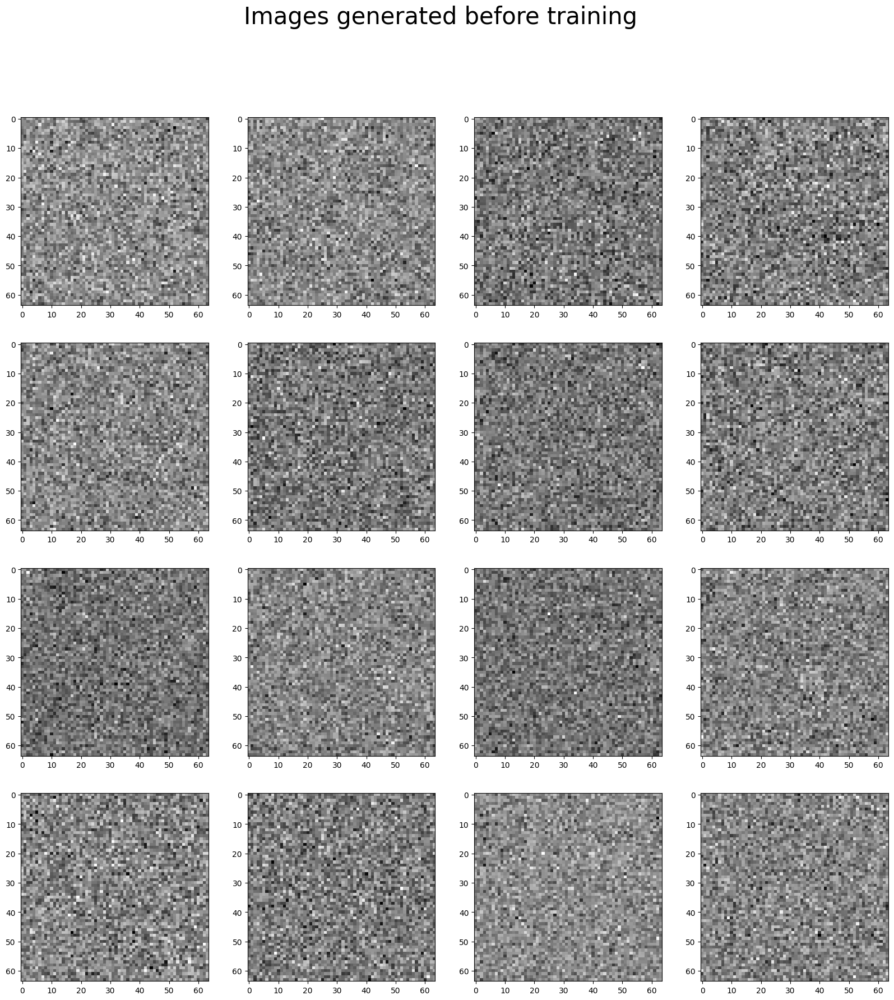

In [19]:
# Optionally, show the denoising (backward) process
class_labels_sample = np.random.choice([0, 1], size=16)  # Randomly select labels
class_labels_tensor_sample = torch.tensor(class_labels_sample).long()
generated = generate_new_images(ddpm,class_labels_tensor_sample, gif_name="before_training.gif")
show_images(generated, "Images generated before training")

# Training loop

The training loop is fairly simple. With each batch of our dataset, we run the forward process on the batch. We use a different timesteps $t$ for each of the `N` images in our `(N, C, H, W)` batch tensor to guarantee more training stability. The added noise is a `(N, C, H, W)` tensor $\epsilon$.

Once we obtained the noisy images, we try to predict $\epsilon$ out of them with our network. We optimize with a simple Mean-Squared Error (MSE) loss.

In [20]:
def training_loop(ddpm, loader, n_epochs, optim, device, display=False, store_path="ddpm_model.pt", early_stopping_patience=3):
    mse = nn.MSELoss()
    bce_loss_fn = nn.BCELoss()
    best_loss = float("inf")
    n_steps = ddpm.n_steps
    loss_list = []
    early_stopping_counter = 0

    for epoch in tqdm(range(n_epochs), desc=f"Training progress", colour="#00ff00"):
        epoch_loss = 0.0
        for step, batch in enumerate(tqdm(loader, leave=False, desc=f"Epoch {epoch + 1}/{n_epochs}", colour="#005500")):
            # Loading data
            x0 = batch[0].to(device)  # Images
            class_labels = batch[1].to(device)  # Class labels
            n = len(x0)

            # Picking some noise for each of the images in the batch, a timestep and the respective alpha_bars
            eta = torch.randn_like(x0).to(device)
            t = torch.randint(0, n_steps, (n,)).to(device)

            # Computing the noisy image based on x0 and the time-step (forward process)
            noisy_imgs,_ = ddpm(x0, t, eta, class_label = class_labels)

            # Getting model estimation of noise based on the images, time-step, and class labels
            eta_theta,_ = ddpm.backward(noisy_imgs, t.reshape(n, -1), class_label= class_labels)

            # Optimizing the MSE between the noise plugged and the predicted noise
            loss = mse(eta_theta, eta)
            optim.zero_grad()
            loss.backward()
            optim.step()

            epoch_loss += loss.item() * len(x0) / len(loader.dataset)

        loss_list.append(epoch_loss)

        # Display images generated at this epoch (optional)
        if display:
            show_images(generate_new_images(ddpm, device=device), f"Images generated at epoch {epoch + 1}")

        log_string = f"Loss at epoch {epoch + 1}: {epoch_loss:.3f}"

        # Storing the model
        if best_loss > epoch_loss:
            best_loss = epoch_loss
            torch.save(ddpm.state_dict(), store_path)
            log_string += " --> Best model ever (stored)"

        print(log_string)

    return loss_list


Training progress:   0%|          | 0/50 [00:00<?, ?it/s]

Epoch 1/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 1: 0.405 --> Best model ever (stored)


Epoch 2/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 2: 0.074 --> Best model ever (stored)


Epoch 3/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 3: 0.050 --> Best model ever (stored)


Epoch 4/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 4: 0.039 --> Best model ever (stored)


Epoch 5/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 5: 0.028 --> Best model ever (stored)


Epoch 6/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 6: 0.024 --> Best model ever (stored)


Epoch 7/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 7: 0.022 --> Best model ever (stored)


Epoch 8/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 8: 0.023


Epoch 9/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 9: 0.020 --> Best model ever (stored)


Epoch 10/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 10: 0.018 --> Best model ever (stored)


Epoch 11/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 11: 0.018 --> Best model ever (stored)


Epoch 12/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 12: 0.019


Epoch 13/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 13: 0.017 --> Best model ever (stored)


Epoch 14/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 14: 0.017


Epoch 15/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 15: 0.017 --> Best model ever (stored)


Epoch 16/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 16: 0.016 --> Best model ever (stored)


Epoch 17/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 17: 0.015 --> Best model ever (stored)


Epoch 18/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 18: 0.016


Epoch 19/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 19: 0.016


Epoch 20/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 20: 0.016


Epoch 21/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 21: 0.017


Epoch 22/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 22: 0.015


Epoch 23/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 23: 0.015


Epoch 24/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 24: 0.015


Epoch 25/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 25: 0.015


Epoch 26/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 26: 0.015


Epoch 27/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 27: 0.015


Epoch 28/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 28: 0.014 --> Best model ever (stored)


Epoch 29/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 29: 0.015


Epoch 30/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 30: 0.015


Epoch 31/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 31: 0.015


Epoch 32/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 32: 0.014


Epoch 33/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 33: 0.014


Epoch 34/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 34: 0.014


Epoch 35/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 35: 0.014 --> Best model ever (stored)


Epoch 36/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 36: 0.014 --> Best model ever (stored)


Epoch 37/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 37: 0.015


Epoch 38/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 38: 0.014


Epoch 39/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 39: 0.013 --> Best model ever (stored)


Epoch 40/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 40: 0.013


Epoch 41/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 41: 0.014


Epoch 42/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 42: 0.016


Epoch 43/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 43: 0.014


Epoch 44/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 44: 0.012 --> Best model ever (stored)


Epoch 45/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 45: 0.014


Epoch 46/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 46: 0.013


Epoch 47/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 47: 0.013


Epoch 48/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 48: 0.013


Epoch 49/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 49: 0.013


Epoch 50/50:   0%|          | 0/82 [00:00<?, ?it/s]

Loss at epoch 50: 0.013
[0.4051381397558136, 0.07358415411111034, 0.05024030208130557, 0.038642883357917594, 0.02759811610120572, 0.024091368975357776, 0.02165208316973747, 0.022680684581307533, 0.019920459040012103, 0.018059498767591328, 0.017964484204361045, 0.018610261037854327, 0.017357524912918636, 0.01739165065752948, 0.016518739537775884, 0.016325449645290705, 0.014868567269181175, 0.016440773988428296, 0.01598520731222044, 0.01582677112720861, 0.016763332219897238, 0.015372100763274303, 0.014899269826253133, 0.015255399848237355, 0.015362055349432246, 0.015398266793805761, 0.014889000480754607, 0.014050433452189696, 0.015210703780954604, 0.014615301082790631, 0.015122122371260744, 0.014416091989702975, 0.014175547361145346, 0.01430384025114811, 0.013992120083307198, 0.013825806697682, 0.014956730675020827, 0.01401304164501421, 0.013144217597240689, 0.01318203003368586, 0.014134002123827948, 0.015501008808978492, 0.013663345273652688, 0.012482055320055939, 0.014155882187873309, 

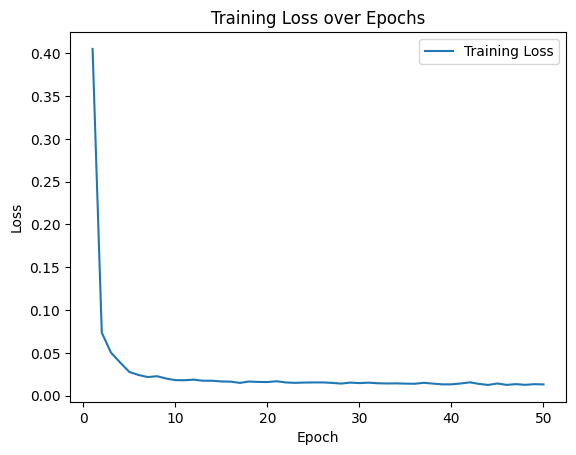

In [21]:
# Training
store_path = "/tf/xray-64.pt"
if not no_train:
    loss_list = training_loop(ddpm, loader, n_epochs, optim=Adam(ddpm.parameters(), lr), device=device, store_path=store_path)

    # Plot the training loss using Matplotlib.
    print(loss_list)
    plt.plot(range(1, len(loss_list) + 1), loss_list, label='Training Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Training Loss over Epochs')
    plt.legend()
    plt.show()


# Testing the trained model

Time to check how well our model does. We re-store the best performing model according to our training loss and set it to evaluation mode. Finally, we display a batch of generated images and the relative obtained and nice GIF.

In [22]:
# Loading the trained model
best_model = MyDDPM(MyUNet(), n_steps=n_steps, device=device)
best_model.load_state_dict(torch.load(store_path, map_location=device, weights_only=True))
best_model.eval()
print("Model loaded")

Model loaded


Generating new images


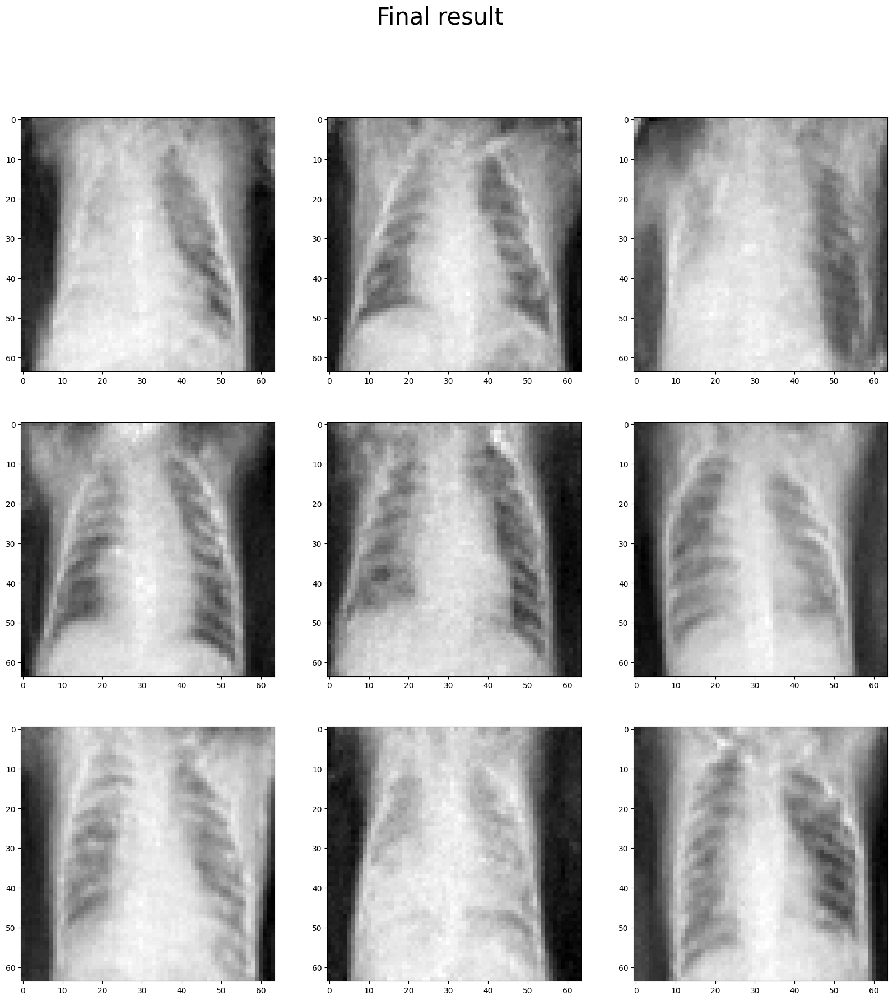

In [23]:
print("Generating new images")
class_labels = np.random.choice([1], size=9) 
class_labels = torch.tensor(class_labels).long()
generated = generate_new_images(
        best_model,
        class_labels,
        n_samples=9,
        device=device,
        gif_name="xray.gif"
    
    )
show_images(generated, "Final result")

In [24]:
import torch
import torch.nn as nn
import numpy as np
from torchvision import models, transforms
from scipy.linalg import sqrtm

# Saving Newly Generated Images

In [25]:
from PIL import Image
import os
import numpy as np

def save_images(images, save_path='images'):
    # Create the folder if it doesn't exist
    os.makedirs(save_path, exist_ok=True)

    # Converting images to CPU numpy arrays and handling the shape and data type
    if type(images) is torch.Tensor:
        images = images.detach().cpu().numpy()

    for i in range(len(images)):
        # Reshape the image to (256, 256) and normalize pixel values to [0, 1]
        image_data = np.squeeze(images[i])  # Remove the singleton dimensions if present
        image_data = (image_data - np.min(image_data)) / (np.max(image_data) - np.min(image_data))

        # Scale the pixel values from 0-1 to 0-255
        scaled_image = (image_data * 255).astype('uint8')

        # Create an image object from the numpy array
        image_obj = Image.fromarray(scaled_image, mode='L')  # 'L' mode for grayscale images

        # Save the image as a PNG file
        image_filename = f'image_{i}.png'
        image_path = os.path.join(save_path, image_filename)
        image_obj.save(image_path)

        print(f'Saved image {i} to {image_path}')


In [26]:
save_images(generated)

Saved image 0 to images/image_0.png
Saved image 1 to images/image_1.png
Saved image 2 to images/image_2.png
Saved image 3 to images/image_3.png
Saved image 4 to images/image_4.png
Saved image 5 to images/image_5.png
Saved image 6 to images/image_6.png
Saved image 7 to images/image_7.png
Saved image 8 to images/image_8.png


# Visualizing the diffusion

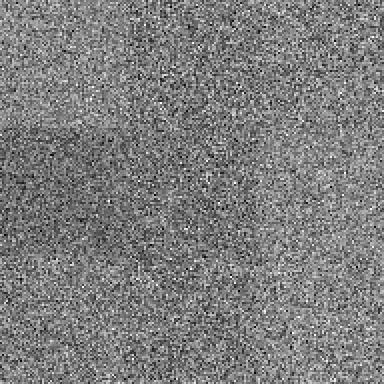

In [27]:
from IPython.display import display, Image
from PIL import Image as PILImage

def resize_gif(input_path, output_path, scale=0.5):
    gif_image = PILImage.open(input_path)

    # Determine the new size
    width, height = gif_image.size
    new_width, new_height = int(width * scale), int(height * scale)

    # Create a list to store frames
    frames = []

    # Iterate through each frame of the GIF
    try:
        while True:
            frames.append(gif_image.copy())
            gif_image.seek(len(frames))  # Move to the next frame
    except EOFError:
        pass

    # Resize each frame and save to a new list
    resized_frames = [frame.resize((new_width, new_height), PILImage.Resampling.LANCZOS) for frame in frames]

    # Save the resized frames as a new GIF
    resized_frames[0].save(output_path, save_all=True, append_images=resized_frames[1:], loop=0)

# Example usage: Resize the 'xray.gif' to 50% and display it
input_gif_path = 'xray.gif'
output_gif_path = 'resized_xray.gif'
resize_gif(input_gif_path, output_gif_path, scale=2)
display(Image(output_gif_path))


# Evaluation


In [28]:
def generate_images(ddpm, class_labels, n_samples=16, device=None, c=1, h=64, w=64):
    """Given a DDPM model, a number of samples to be generated and a device, returns some newly generated samples"""
    
    with torch.no_grad():
        if device is None:
            device = ddpm.device

        # Starting from random noise
        x = torch.randn(n_samples, c, h, w).to(device)
        class_labels = class_labels.to(device)

        for t in reversed(range(ddpm.n_steps)):
            # Estimating noise to be removed
            time_tensor = torch.full((n_samples, 1), t, dtype=torch.long, device=device)
            eta_theta,_ = ddpm.backward(x, time_tensor, class_labels)

            # Get alpha_t and alpha_t_bar on the correct device
            alpha_t = ddpm.alphas[t].to(device)
            alpha_t_bar = ddpm.alpha_bars[t].to(device)

            # Partially denoise the image
            x = (1 / alpha_t.sqrt()) * (x - (1 - alpha_t) / (1 - alpha_t_bar).sqrt() * eta_theta)

            if t > 0:
                z = torch.randn(n_samples, c, h, w).to(device)
                beta_t = ddpm.betas[t].to(device)
                sigma_t = beta_t.sqrt()
                x = x + sigma_t * z

        # Return the final generated images
        return x


In [29]:
import torch
import tensorflow as tf

def convert_pytorch_to_tensorflow(pytorch_tensor):

    # Check if the tensor is on a GPU and move it to the CPU if necessary
    if pytorch_tensor.is_cuda:
        pytorch_tensor = pytorch_tensor.cpu()

    # Convert PyTorch tensor to NumPy array
    numpy_array = pytorch_tensor.numpy()

    # Convert NumPy array to TensorFlow tensor
    tensorflow_tensor = tf.convert_to_tensor(numpy_array)

    # Transpose the tensor from (batch_size, channels, height, width) -> (batch_size, height, width, channels)
    if len(tensorflow_tensor.shape) == 4:  # Only transpose if it's a 4D tensor (batch of images)
        tensorflow_tensor = tf.transpose(tensorflow_tensor, perm=[0, 2, 3, 1])

    return tensorflow_tensor


In [30]:
def calculate_fid(real_images, generated_images):
    import numpy as np
    from scipy.linalg import sqrtm
    from keras.applications.inception_v3 import InceptionV3, preprocess_input
    import tensorflow as tf

    # Resize images to 299x299
    real_images_resized = tf.image.resize(real_images, (299, 299), method='bicubic')
    generated_images_resized = tf.image.resize(generated_images, (299, 299), method='bicubic')

    # Load InceptionV3 model
    model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))

    # Get activations
    act_real = model.predict(real_images_resized)
    act_gen = model.predict(generated_images_resized)

    # Calculate mean and covariance
    mu_real, sigma_real = np.mean(act_real, axis=0), np.cov(act_real, rowvar=False)
    mu_gen, sigma_gen = np.mean(act_gen, axis=0), np.cov(act_gen, rowvar=False)

    # Calculate FID score
    ssdiff = np.sum((mu_real - mu_gen) ** 2)
    covmean = sqrtm(sigma_real.dot(sigma_gen))

    # Numerical error handling
    if np.iscomplexobj(covmean):
        covmean = covmean.real

    fid = ssdiff + np.trace(sigma_real + sigma_gen - 2 * covmean)
    return fid

In [31]:
def calculate_kid(real_images, generated_images):
    import numpy as np
    from scipy.linalg import sqrtm
    from sklearn.metrics.pairwise import polynomial_kernel
    from keras.applications.inception_v3 import InceptionV3, preprocess_input
    import tensorflow as tf

    # Resize images to 299x299 pixels
    real_images_resized = tf.image.resize(real_images, (299, 299), method='bicubic')
    generated_images_resized = tf.image.resize(generated_images, (299, 299), method='bicubic')


    # Load pre-trained InceptionV3 model
    inception_model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))

    # Get the activations
    act_real = inception_model.predict(real_images_resized)
    act_gen = inception_model.predict(generated_images_resized)

    # Compute polynomial kernels
    kernel_real = polynomial_kernel(act_real, degree=3, gamma=None, coef0=1)
    kernel_gen = polynomial_kernel(act_gen, degree=3, gamma=None, coef0=1)
    kernel_cross = polynomial_kernel(act_real, act_gen, degree=3, gamma=None, coef0=1)

    m = len(act_real)
    n = len(act_gen)

    # Calculate KID score
    kid = (np.sum(kernel_real) / (m * m)) + (np.sum(kernel_gen) / (n * n)) - (2 * np.sum(kernel_cross) / (m * n))
    return kid


In [32]:
def convert_grayscale_to_rgb(images):
    # Convert numpy array to TensorFlow tensor
    images_tensor = tf.convert_to_tensor(images)
    # Convert grayscale images to RGB
    return tf.image.grayscale_to_rgb(images_tensor)


In [33]:
import torch
import numpy as np
import tensorflow as tf

def generate_images_in_batches(model, total_samples, batch_size, device):
    all_generated_images = []
    all_generated_labels = []

    for i in range(0, total_samples, batch_size):
        current_batch_size = min(batch_size, total_samples - i)
        # Generate random class labels for this batch
        class_labels = np.random.choice([0, 1], size=current_batch_size)
        class_labels_tensor = torch.tensor(class_labels).long().to(device)
        
        # Generate images for this batch
        generated_images = generate_images(model, class_labels=class_labels_tensor, n_samples=current_batch_size, device=device)
        
        # Convert class labels to one-hot encoding
        generated_labels = tf.keras.utils.to_categorical(class_labels, num_classes=2)
        
        # Append the generated images and labels
        all_generated_images.append(generated_images)
        all_generated_labels.append(generated_labels)

        print(f"Batch {i // batch_size + 1}/{(total_samples + batch_size - 1) // batch_size} generated.")

    # Concatenate all batches
    all_generated_images = torch.cat(all_generated_images, dim=0)
    all_generated_labels = np.concatenate(all_generated_labels, axis=0)

    return all_generated_images, all_generated_labels

# Parameters
total_samples = 30000
batch_size = 2000  # Adjust batch size based on available memory

# Generate images in batches
generated_images, generated_labels = generate_images_in_batches(best_model, total_samples, batch_size, device)


Batch 1/15 generated.
Batch 2/15 generated.
Batch 3/15 generated.
Batch 4/15 generated.
Batch 5/15 generated.
Batch 6/15 generated.
Batch 7/15 generated.
Batch 8/15 generated.
Batch 9/15 generated.
Batch 10/15 generated.
Batch 11/15 generated.
Batch 12/15 generated.
Batch 13/15 generated.
Batch 14/15 generated.
Batch 15/15 generated.


In [34]:
def normalize_tensor(tensor):
    # Find the minimum and maximum values of the tensor
    min_val = tf.reduce_min(tensor)
    max_val = tf.reduce_max(tensor)
    
    # Normalize the tensor to [0, 1]
    normalized_tensor = (tensor - min_val) / (max_val - min_val)
    
    # Scale the normalized tensor to [-1, 1]
    normalized_tensor_neg_one_to_one = (normalized_tensor * 2) - 1
    
    return normalized_tensor_neg_one_to_one


In [35]:
# Convert pytorch tensors to tensorflow tensors for evaluation
images_tf = convert_pytorch_to_tensorflow(images)
labels_tf = convert_pytorch_to_tensorflow(labels)

generated_images_tf = convert_pytorch_to_tensorflow(generated_images)
generated_labels_tf = generated_labels

In [36]:
from tensorflow.keras.applications import VGG16
from sklearn.metrics.pairwise import polynomial_kernel
images_normalized = normalize_tensor(images_tf)
generated_images_normalized = normalize_tensor(generated_images_tf)

# Convert grayscale images to RGB
real_images_rgb = convert_grayscale_to_rgb(images_tf)
generated_images_rgb = convert_grayscale_to_rgb(generated_images_tf)

# Calculate FID and KID scores
fid_score = calculate_fid(real_images_rgb, generated_images_rgb)
kid_score = calculate_kid(real_images_rgb, generated_images_rgb)

print(f'FID Score: {fid_score}')
print(f'KID Score: {kid_score}')


938/938 [==============================] - 42s 43ms/step
FID Score: 1402.9729979218198
KID Score: 3.684730229529987


In [37]:
from keras.layers import Conv2D, Conv2DTranspose, Dropout, Dense, Reshape, LayerNormalization, LeakyReLU
from keras import layers, models

In [38]:
# Building and training the VGG16-based classifier
basemodel = tf.keras.applications.VGG16(weights=None, input_shape=(64, 64, 1), pooling='max', include_top=False)
x = layers.Dropout(0.4)(basemodel.output)
x = layers.Dense(128)(x)
x = layers.BatchNormalization()(x)
x = layers.LeakyReLU(alpha=0.2)(x)
x = layers.Dropout(0.4)(x)
x = layers.Dense(32)(x)
x = layers.BatchNormalization()(x)
x = layers.LeakyReLU(alpha=0.2)(x)
x = layers.Dropout(0.4)(x)
x = layers.Dense(1, activation='sigmoid')(x)
m = tf.keras.models.Model(inputs=basemodel.input, outputs=x)
m.compile(loss='binary_crossentropy', optimizer=tf.keras.optimizers.Adam(learning_rate=0.00002), run_eagerly=True)
m.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 64, 64, 1)]       0         
                                                                 
 block1_conv1 (Conv2D)       (None, 64, 64, 64)        640       
                                                                 
 block1_conv2 (Conv2D)       (None, 64, 64, 64)        36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 32, 32, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 32, 32, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 32, 32, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 16, 16, 128)       0     

In [39]:
history = m.fit(generated_images_tf, np.argmax(generated_labels_tf, axis=1), epochs=60, batch_size=64,
                         validation_split=0.2, 
                         callbacks=[tf.keras.callbacks.EarlyStopping(patience=3, monitor='val_loss', mode='min',
                                                                     restore_best_weights=True)])

Epoch 1/60


I0000 00:00:1729197834.538446  579012 device_compiler.h:186] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


375/375 [==============================] - 46s 92ms/step - loss: 0.8270 - val_loss: 0.6953
Epoch 2/60
375/375 [==============================] - 31s 81ms/step - loss: 0.7702 - val_loss: 0.6963
Epoch 3/60
375/375 [==============================] - 31s 84ms/step - loss: 0.6967 - val_loss: 0.6926
Epoch 4/60
375/375 [==============================] - 30s 81ms/step - loss: 0.5019 - val_loss: 0.2052
Epoch 5/60
375/375 [==============================] - 32s 84ms/step - loss: 0.1688 - val_loss: 0.1182
Epoch 6/60
375/375 [==============================] - 32s 84ms/step - loss: 0.1244 - val_loss: 0.0807
Epoch 7/60
375/375 [==============================] - 31s 82ms/step - loss: 0.1038 - val_loss: 0.1107
Epoch 8/60
375/375 [==============================] - 33s 87ms/step - loss: 0.0964 - val_loss: 0.0734
Epoch 9/60
375/375 [==============================] - 31s 82ms/step - loss: 0.0826 - val_loss: 0.1384
Epoch 10/60
375/375 [==============================] - 31s 82ms/step - loss: 0.0744 - val_los

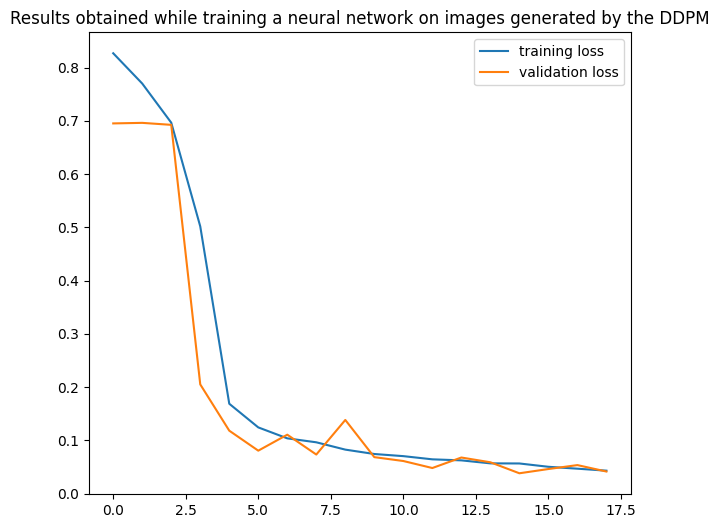

In [40]:
# Plotting the training and validation loss
plt.figure(figsize=(7, 6))
plt.plot(history.history['loss'], label='training loss')
plt.plot(history.history['val_loss'], label='validation loss')
plt.title('Results obtained while training a neural network on images generated by the DDPM')
plt.legend()
plt.show()

In [41]:
import cv2
import pathlib

In [42]:
class ReadDataset:
    def __init__(self, datasetpath, labels, image_shape):
        self.datasetpath = datasetpath
        self.labels = labels
        self.image_shape = image_shape
    def returListImages(self,):
        self.images = []
        for label in self.labels:
            self.images.append(list(pathlib.Path(os.path.join(self.datasetpath,
                                                              label)).glob('*.*')))
    def readImages(self,):
        self.returListImages()
        self.finalImages = []
        labels = []
        for label in range(len(self.labels)):
            for img in self.images[label]:
                img = cv2.imread(str(img), cv2.IMREAD_GRAYSCALE)
                img = cv2.resize(img , self.image_shape[:2])
                img  = img/255
                img = np.expand_dims(img, axis=-1)  # Add channel dimension to get shape (64, 64, 1)
                self.finalImages.append(img)
                labels.append(label)
        images = np.array(self.finalImages)
        labels = np.array(labels)
        return images, labels

In [43]:
readDatasetObject = ReadDataset('/tf/chest_xray/test',
                               ['NORMAL', 'PNEUMONIA'],
                               (64, 64))
images_test, labels_test = readDatasetObject.readImages()

In [44]:
from sklearn.metrics import confusion_matrix
import seaborn as sns
import pandas as pd
from sklearn.metrics import accuracy_score, classification_report
from sklearn.metrics import f1_score, recall_score, precision_score
def calculate_metrics(model, images, labels):
    loss = model.evaluate(images, labels, verbose=0)  
    y_pred = tf.squeeze(model.predict(images))
    y_pred = y_pred >= 0.5
    y_pred = np.array(y_pred, dtype='int32')
    labels = np.array(labels, dtype='int32')
    acc = accuracy_score(y_pred, labels) * 100
    f1 = f1_score(y_pred, labels) * 100
    recall = recall_score(y_pred, labels) * 100
    precision = precision_score(y_pred, labels) * 100
    cm = confusion_matrix(y_pred, labels)
    cmObject = pd.DataFrame(cm , index = ['NORMAL', 'PNEUMONIA'],
                        columns = ['NORMAL', 'PNEUMONIA'])
    sns.heatmap(cmObject, annot = True, cmap="Blues")
    return {
        'accuracy': acc,
        'f1_score': f1,
        'recall': recall,
        'precision': precision,
        'confusion_matrix': cm
    }


20/20 [==============================] - 0s 15ms/step
1:1 Ratio -> Accuracy: 86.22%, F1 Score: 89.54%, Recall: 85.19%, Precision: 94.36%


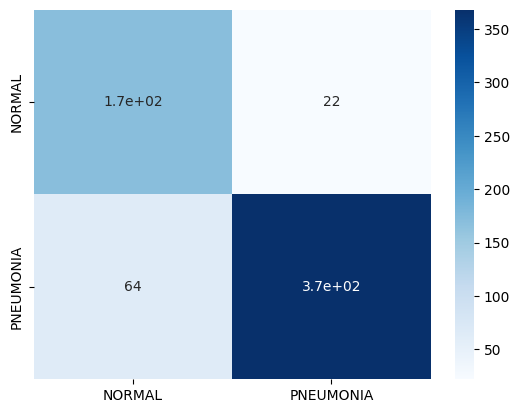

In [45]:
metrics = calculate_metrics(m, images_test, labels_test)
print(f"1:1 Ratio -> Accuracy: {metrics['accuracy']:.2f}%, F1 Score: {metrics['f1_score']:.2f}%, "
      f"Recall: {metrics['recall']:.2f}%, Precision: {metrics['precision']:.2f}%")

In [46]:
print(metrics['confusion_matrix'])

[[170  22]
 [ 64 368]]
